<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 15px; height: 80px">

# TROLL HUNTING: DETECTING STATE-BACKED DISINFORMATION CAMPAIGNS ON TWITTER

# NOTEOOK 3.0: MODELLING AND EVALUATION
The building, evaluation and explanation of the classification models will take place across the 3-series of the notebooks in this project. This separation is necessary as the pipeline takes some time to run.

WARNING: This notebook will take hours to re-run due to the Random Forest model. The full pipeline took over 7 hours to run on a late-2015 iMAc. The Naive Bayes and Logistic Regression models, however, completed their pipeline runs relatively quickly, so one option is to comment out the RFC portion if needed. 

In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import shap

from sklearn import metrics
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.externals import joblib
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score, GridSearchCV, train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, f1_score, mean_squared_error, precision_score, recall_score
from sklearn.pipeline import Pipeline, make_pipeline
from yellowbrick.features.importances import FeatureImportances

shap.initjs()
mpl.rcParams["figure.dpi"] = 300
%matplotlib inline
%config InlineBackend.figure_format ='retina'

## 1. PREPROCESSING

In [2]:
# Calling up the training datasets
state = pd.read_csv('../data/state.csv')
real = pd.read_csv('../data/real.csv')
pd.set_option('display.max_columns', 25)

In [3]:
#Creating a new col to classify the real Vs state-backed tweets
state['bot_or_not'] = 1
real['bot_or_not'] = 0

In [4]:
# Sampling 25K tweets from each training set for a 50K training set
state_50sample = state.sample(n=25000, random_state=42).copy()
real_50sample = real.sample(n=25000, random_state=42).copy()

In [5]:
combo5050 = pd.concat((state_50sample, real_50sample), axis=0)

In [6]:
combo5050.shape

(50000, 23)

In [7]:
combo5050.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 50000 entries, 33553 to 47138
Data columns (total 23 columns):
tweetid                        50000 non-null int64
user_screen_name               50000 non-null object
user_reported_location         50000 non-null object
user_profile_description       50000 non-null object
follower_count                 50000 non-null int64
following_count                50000 non-null int64
follower-to-following_ratio    50000 non-null float64
account_creation_date          50000 non-null object
year_of_account_creation       50000 non-null int64
month_of_account_creation      50000 non-null int64
tweet_time                     50000 non-null object
tweet_year                     50000 non-null int64
tweet_month                    50000 non-null int64
tweet_day                      50000 non-null int64
tweet_text                     50000 non-null object
clean_tweet_text               49836 non-null object
hashtags                       50000 non-null 

In [8]:
# There are 164 empty rows in 'clean_tweet_text', likely due to the removal of emojis.
# I'll replace them with a generic "missing text" entry, which shouldn't affect the results
combo5050['clean_tweet_text'] = combo5050['clean_tweet_text'].fillna("missing text")

In [9]:
# I'm outputting this for use in subsequent notebooks
# training_set = combo5050.to_csv('../data/combo5050.csv', index=False)

## 1.1 SPLIT THE TRAINING DATA

In [10]:
y = combo5050['bot_or_not']
X = combo5050['clean_tweet_text']

In [11]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

## 2. SETTING A BASELINE PERFORMANCE VIA DUMMY CLASSIFIER

In [12]:
dummy = DummyClassifier(strategy='stratified', random_state=42)

In [13]:
dummy.fit(X_train, y_train)

DummyClassifier(constant=None, random_state=42, strategy='stratified')

In [14]:
dummy_pred = dummy.predict(X_test)

In [15]:
print("Accuracy Score:", accuracy_score(y_test, dummy_pred))
print("Precision Score : ", precision_score(y_test, dummy_pred))
print("Recall Score:", recall_score(y_test, dummy_pred))
print("f1 Score:", f1_score(y_test, dummy_pred))

Accuracy Score: 0.50864
Precision Score :  0.5080645161290323
Recall Score: 0.5145739910313901
f1 Score: 0.5112985359643539


## 3. PIPELINE FOR 3 CLASSIFIERS
I'll try three of the most commonly used classifiers - Naive Bayes, Logistic Regression and Random Forest - and see which one performs best. I had tried more complex models as well, such as the Gradient Boosting Classifier. But they were too computationally expensive, due the size of the dataset, and I aborted their pipeline runs after more than 24 hours with no end in sight.

In [18]:
models = {
    "Naive Bayes": (
        Pipeline(
            [
                ("vect", CountVectorizer()),
                ("tfidf", TfidfTransformer()),
                ("clf", MultinomialNB()),
            ]
        ),
        {
            "vect__stop_words": ["english"],
            "vect__min_df": [1],
            "vect__max_df": (0.5, 1.0),
            "vect__max_features": [None],
            "vect__ngram_range": [(1, 2)],  
            "tfidf__use_idf": [True, False],
            "tfidf__norm": ["l2"],
            "clf__alpha": [0.1],
        },
    ),
    "LogReg": (
        Pipeline(
            [
                ("vect", CountVectorizer()),
                ("tfidf", TfidfTransformer()),
                ("clf", LogisticRegression()),
            ]
        ),
        {
            "vect__stop_words": ["english"],
            "vect__min_df": [1],
            "vect__max_df": (0.5, 1.0),
            "vect__max_features": [None],
            "vect__ngram_range": [(1, 2)],  
            "tfidf__use_idf": [True, False],
            "tfidf__norm": ["l2"],
            "clf__penalty": ["l2"],
            "clf__C": np.logspace(-4, 4, 40),
            "clf__solver": ["liblinear"],
        },
    ),
    "Random Forest": (
        Pipeline(
            [
                ("vect", CountVectorizer()),
                ("tfidf", TfidfTransformer()),
                ("clf", RandomForestClassifier()),
            ]
        ),
        {
            "vect__stop_words": ["english"],
            "vect__min_df": [1],
            "vect__max_df": [0.5],
            "vect__max_features": [None],
            "vect__ngram_range": [(1, 2)],  
            "tfidf__use_idf": [True, False],
            "tfidf__norm": ["l2"],
            "clf__n_estimators": [100, 200, 500, 1000],
            "clf__criterion": ["gini", "entropy"],
            "clf__class_weight": ["balanced"],
        },
    ),
}

In [19]:
for name, (model, parameters) in models.items():
    print("----- {} -----".format(name))
    gs = GridSearchCV(model, parameters, cv=5, verbose=0, n_jobs=-1, scoring="roc_auc")
    gs.fit(X_train, y_train)
    print("Best Parameters:", gs.best_params_)
    print("")
    print("Best Score:", gs.best_score_)

    joblib.dump(gs.best_estimator_, f"{name}.pkl", compress=1)
    joblib.dump(gs.cv_results_, f"{name}_results.pkl", compress=1)

    y_pred = gs.predict(X_test)

    print("")
    print("Precision Score :", precision_score(y_test, y_pred))
    print("Recall Score:", recall_score(y_test, y_pred))
    print("f1 Score:", f1_score(y_test, y_pred))
    # print(classification_report(y_test, y_pred))
    print("")

----- Naive Bayes -----
Best Parameters: {'clf__alpha': 0.1, 'tfidf__norm': 'l2', 'tfidf__use_idf': False, 'vect__max_df': 0.5, 'vect__max_features': None, 'vect__min_df': 1, 'vect__ngram_range': (1, 2), 'vect__stop_words': 'english'}

Best Score: 0.9400765359673007

Precision Score : 0.8917748917748918
Recall Score: 0.824791800128123
f1 Score: 0.8569764539479159

----- LogReg -----
Best Parameters: {'clf__C': 55.41020330009492, 'clf__penalty': 'l2', 'clf__solver': 'liblinear', 'tfidf__norm': 'l2', 'tfidf__use_idf': True, 'vect__max_df': 0.5, 'vect__max_features': None, 'vect__min_df': 1, 'vect__ngram_range': (1, 2), 'vect__stop_words': 'english'}

Best Score: 0.9423818152158162

Precision Score : 0.8897183576518494
Recall Score: 0.8398462524023063
f1 Score: 0.8640632723677707

----- Random Forest -----
Best Parameters: {'clf__class_weight': 'balanced', 'clf__criterion': 'entropy', 'clf__n_estimators': 1000, 'tfidf__norm': 'l2', 'tfidf__use_idf': False, 'vect__max_df': 0.5, 'vect__max_

In [36]:
NB_results = joblib.load("Naive Bayes_results.pkl")
#NB_results

I've commented out the details of the CV results. But I wanted to see how long it took to fit the model, which could be a consideration in the eventual model picked. Here are the timings for the NB model:

'mean_fit_time': [1.72690649, 1.66129384, 1.70278912, 1.42708278]

'std_fit_time': [0.13678816, 0.25283851, 0.16120502, 0.09079708]

'mean_score_time': [0.17118282, 0.18741198, 0.211309  , 0.16651206])

'std_score_time': [0.00292404, 0.02398684, 0.02484516, 0.00918779])

In [35]:
LR_results = joblib.load("LogReg_results.pkl")
#LR_results

Here are the timings for the LogReg model (just top 4):

mean_fit_time: [1.57593017, 1.52490311, 1.47265816, 1.46392283]

std_fit_time: [0.03306572, 0.01339237, 0.02080275, 0.0117235]

mean_score_time: [0.17275205, 0.16987195, 0.16462364, 0.16391244]

std_score_time: [0.00919242, 0.01086673, 0.00955436, 0.00949919]

In [34]:
RFC_results = joblib.load("Random Forest_results.pkl")
#RFC_results

Here are the timings for the RFC model (just top 4):

mean_fit_time: [ 285.03215604,  282.98463936,  557.45753379,  576.6304266]

std_fit_time: [  2.35367588,   2.74712298,  10.26395326,   8.5757578]

mean_score_time: [ 1.55674815,  1.61147542,  3.00969305,  3.13662944]

std_score_time: [0.07034992, 0.05381689, 0.04129827, 0.02548991]

### ANALYSIS:
Overall, it looks like the LogReg model is the best option. It has the best f1 score, the key criteria for me at this moment as I need a model that is good at picking out both fake and real tweets (true positives and true negatives). Most importantly, it also fitted really fast. 

In comparison, the Random Forest model took a long time to fit, and did not deliver a superior performance in either precision or recall to justify the time required to run.

### I will go with the LogReg model going ahead. Do note that I'm NOT including the pkl files for the Naive Bayes and Random Forest models in this repo, in order to keep the overall file size manageable.

### 4. TESTING THE LOGREG MODEL AGAINST AN UNSEEN TEST SET
First, let's load the saved logreg model and fit it with the full training dataset

In [16]:
LR = joblib.load("logreg.pkl")

In [17]:
# Showing the finalised LR model the full training data-set, ahead of testing it on unseen data
LR.fit(X,y)

Pipeline(memory=None,
     steps=[('vect', CountVectorizer(analyzer='word', binary=False, decode_error='strict',
        dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
        lowercase=True, max_df=0.5, max_features=None, min_df=1,
        ngram_range=(1, 2), preprocessor=None, stop_words='english',
        ...ty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False))])

### 4.1 A 50-50 TEST
Let's start with an easy test, with an even mix of fake and real tweets among the 100 tweets that we will test the model on. 

In [18]:
# Calling up the Russian unseen test dataset created in notebook 1.4 Section 1
russian_unseen = pd.read_csv('../data/russian_unseen.csv')

In [19]:
# I won't need to test the entire unseen set against the model, so let's drop the empty rows
russian_unseen = russian_unseen.dropna()

In [20]:
# Grab a sample of 100 tweets from the unseen set
russian_test = russian_unseen.sample(n=100, random_state=42)

In [21]:
y_russian = russian_test['bot_or_not']
X_russian = russian_test['clean_tweet_text']

In [22]:
y_russian.value_counts()

1    50
0    50
Name: bot_or_not, dtype: int64

In [23]:
pred_russian5050 = LR.predict(X_russian)
pred_russian5050

array([1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1,
       1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1,
       1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0,
       1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1])

In [24]:
cm_russian5050 = confusion_matrix(y_russian, pred_russian5050)
cm_russian5050

array([[44,  6],
       [ 4, 46]])

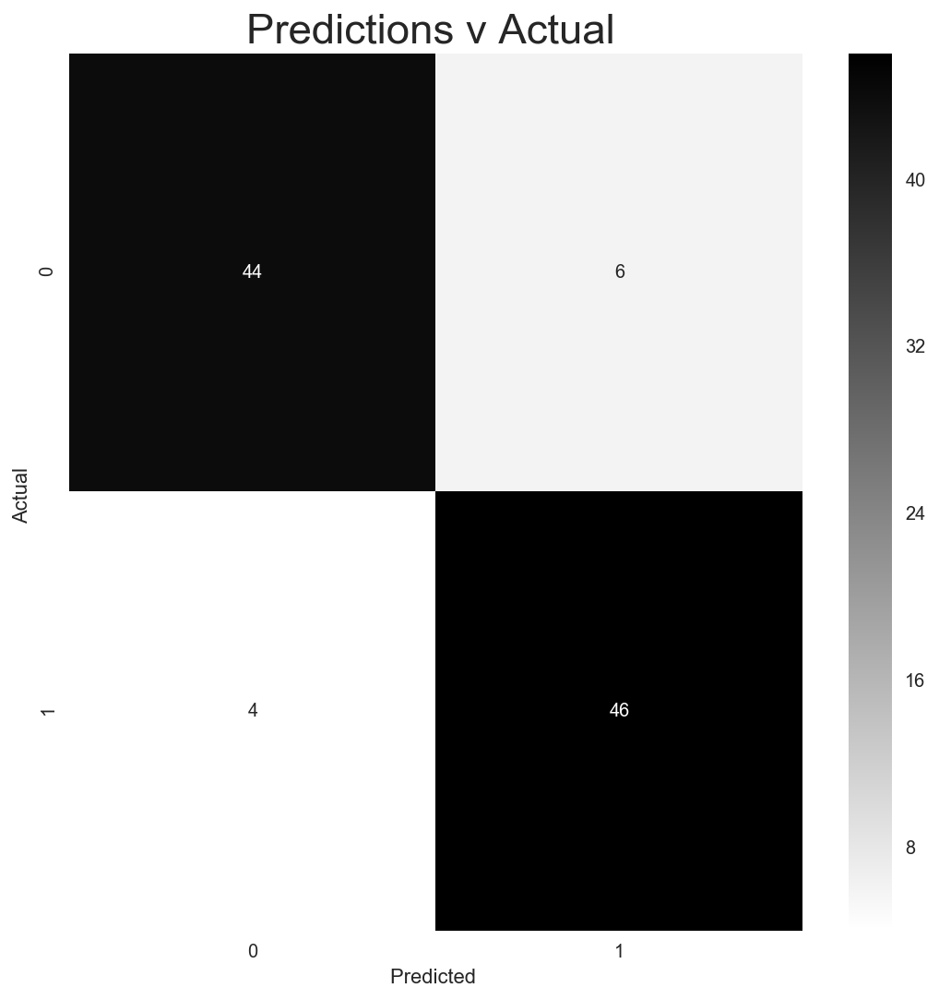

In [25]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_russian5050, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.9)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [26]:
print("Accuracy Score:", accuracy_score(y_russian, pred_russian5050))
print("Precision Score :", precision_score(y_russian, pred_russian5050))
print("Recall Score:", recall_score(y_russian, pred_russian5050))
print("f1 Score:", f1_score(y_russian, pred_russian5050))

Accuracy Score: 0.9
Precision Score : 0.8846153846153846
Recall Score: 0.92
f1 Score: 0.9019607843137256


### ANALYSIS:
The LogReg model did surprisingly well on its first test with an unseen test set, with high precision and Recall scores. The model wrongly classified just 10 out of 100 tweets. 

Of the 50 fake tweets, the model correctly classified 46 of them. It wrongly classified 6 real tweets as fake tweets, and classified 4 fake tweets as real tweets.

While encouraging, the results from this test set aren't that surprising given the high number of fake tweets. Let's give the model a tougher challenge by reducing the number of fake tweets in the test sample and see if it can still classify correctly. I'll start with a 70-30 split.

### 4.2 A 70-30 TEST
This time, I'll shift the sampling weight such that the unseen test set has about 70% real tweets and 30% fake tweets.

In [27]:
russian_unseen['70real_30fake'] = np.where(russian_unseen['bot_or_not'] == 0, 0.7, 0.3)

In [28]:
russian_test7030 = russian_unseen.sample(n=100, random_state=42, weights='70real_30fake')

In [29]:
y_russian7030 = russian_test7030['bot_or_not']
X_russian7030 = russian_test7030['clean_tweet_text']

In [30]:
# The split is not precise, but close enough
y_russian7030.value_counts()

0    68
1    32
Name: bot_or_not, dtype: int64

In [31]:
pred_unseen7030 = LR.predict(X_russian7030)
pred_unseen7030

array([0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1,
       1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0,
       1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0])

In [32]:
cm_unseen7030 = confusion_matrix(y_russian7030, pred_unseen7030)
cm_unseen7030

array([[62,  6],
       [ 2, 30]])

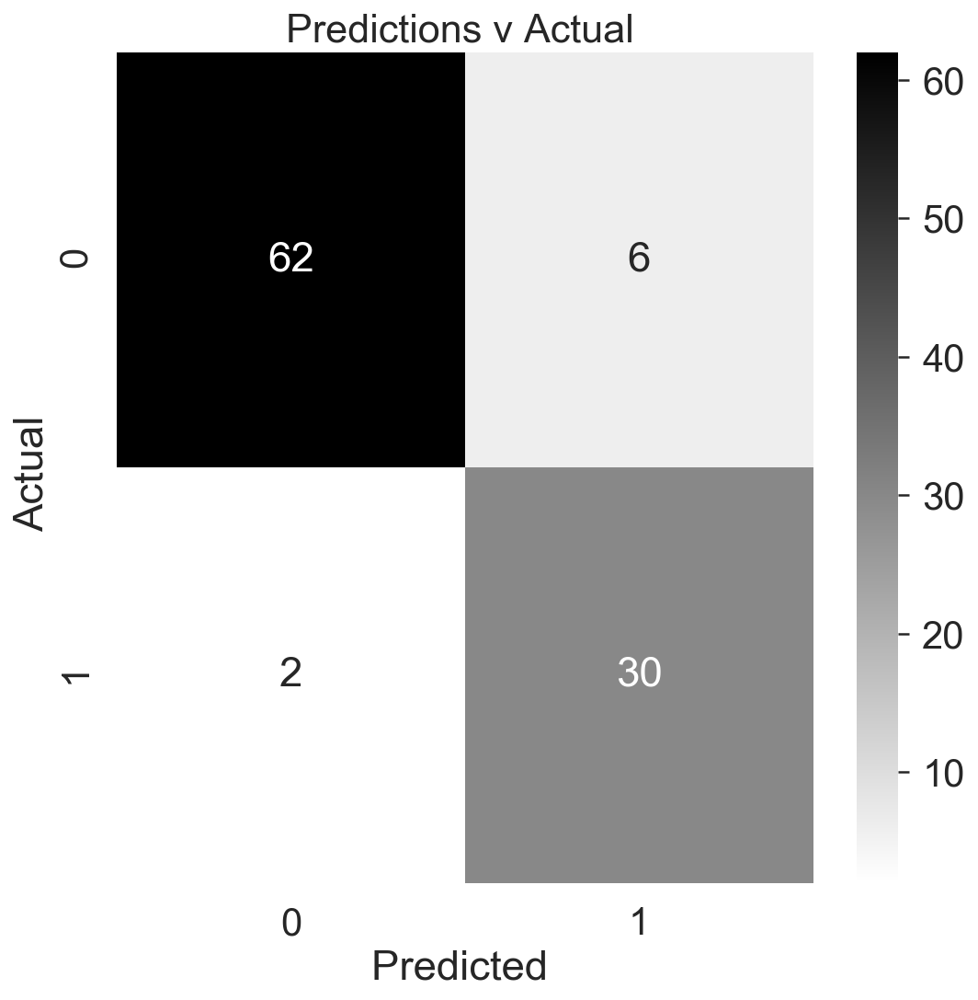

In [33]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_unseen7030, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.8)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [34]:
print("Accuracy Score:", accuracy_score(y_russian7030, pred_unseen7030))
print("Precision Score :", precision_score(y_russian7030, pred_unseen7030))
print("Recall Score:", recall_score(y_russian7030, pred_unseen7030))
print("f1 Score:", f1_score(y_russian7030, pred_unseen7030))

Accuracy Score: 0.92
Precision Score : 0.8333333333333334
Recall Score: 0.9375
f1 Score: 0.8823529411764706


### ANALYSIS:
Surprisingly, the model's performance is unaffected, and its recall and precision scores remain high.

Its overall accuracy in fact improved, as it correctly classified 92 out of 100 tweets. It only misclassified 8 tweets this time, compared to 10 misclassified tweets in the 50-50 test set.

This time, the model failed to catch 2 of the fake tweets, classifying them as real. It only misclassified 8.8% of the real tweets, wrongly identifying 6 real tweets as fake tweets by state-backed operators.

Let's see how the model performs in a 90-10 split, with even fewer fake tweets this time.

### 4.3 A 90-10 TEST
Now I'll shift the sampling weight such that the unseen test set has about 90% real tweets and 10% fake tweets.

In [35]:
russian_unseen['90real_10fake'] = np.where(russian_unseen['bot_or_not'] == 0, 0.9, 0.1)

In [36]:
russian_test9010 = russian_unseen.sample(n=100, random_state=42, weights='90real_10fake')

In [37]:
y_russian9010 = russian_test9010['bot_or_not']
X_russian9010 = russian_test9010['clean_tweet_text']

In [38]:
# The split is not precise, but close enough
y_russian9010.value_counts()

0    87
1    13
Name: bot_or_not, dtype: int64

In [39]:
pred_unseen9010 = LR.predict(X_russian9010)
pred_unseen9010

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0])

In [40]:
cm_unseen9010 = confusion_matrix(y_russian9010, pred_unseen9010)
cm_unseen9010

array([[84,  3],
       [ 0, 13]])

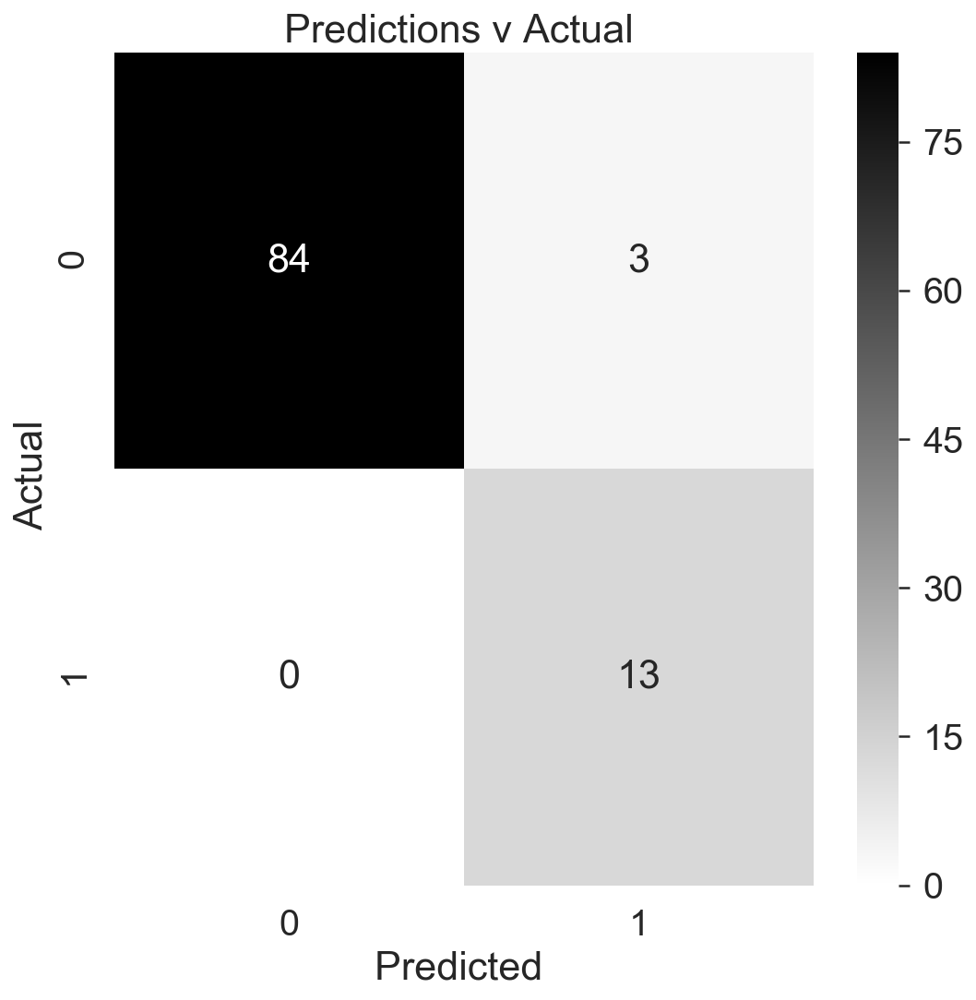

In [41]:
plt.figure(figsize=(8,8))
sns.heatmap(cm_unseen9010, annot=True, fmt="d", cmap="gist_gray_r")
sns.set(font_scale=1.8)
plt.title("Predictions v Actual ")
plt.ylabel("Actual ")
plt.xlabel("Predicted ")
plt.tight_layout()

In [42]:
print("Accuracy Score:", accuracy_score(y_russian9010, pred_unseen9010))
print("Precision Score :", precision_score(y_russian9010, pred_unseen9010))
print("Recall Score:", recall_score(y_russian9010, pred_unseen9010))
print("f1 Score:", f1_score(y_russian9010, pred_unseen9010))

Accuracy Score: 0.97
Precision Score : 0.8125
Recall Score: 1.0
f1 Score: 0.896551724137931


### ANALYSIS:
The LogReg model continues its impressive performance, doing even better this time round by correctly classifying 97 out of 100 tweets, and getting all 13 fake tweets correct - giving it a perfect Recall score. The model made a mistake with just 3 tweets, classifying them as fake when they are tweets by real users.

Overall, the model seems to have held up pretty well in different test scenarios. Let's try to analyse and better understand the model's predictive performance. 

## 5. CLOSER LOOK AT THE WRONGLY CLASSIFIED TWEETS
Let's take a closer at the misclassified tweets to see if they have anything in common. In our tests so far, the model has thrown up more false positives than false negatives, ie, tweets which it classified as fake when they were in fact real. So let's focus on the tweets that triggered the false positives.

## 5.1 WRONGLY CLASSIFIED TWEETS IN THE 5050 TEST SET

In [43]:
# Starting with false positives in the 50-50 set
russian_test['pred'] = pred_russian5050

In [44]:
#russia = russian_test.to_csv('../data/rus100.csv')

In [45]:
wrong_predictions5050 = russian_test[russian_test['pred'] != russian_test['bot_or_not']]

In [46]:
wrong_predictions5050['tweet_text'].values

array(['@PatrickSvitek https://t.co/zUUV42j4nY',
       "If they can't control their own emails maybe they shouldn't be controlling the state secrets of the US ~Huckabee #YesSheCan #Pressconference https://t.co/3x9kaHKKNf",
       '88 drug offenders arrested, S$74,000 worth of drugs seized in islandwide operation https://t.co/ssXcpIcRO1 https://t.co/63RKbcPOH5',
       'Arizona to provide new path for asthma relief for students https://t.co/ZMk0jJIGju https://t.co/HnA6MHFNsm',
       'The Silence of the Griled Lambs #MakeABookWarm https://t.co/lHejeS0Ccb',
       'When Clinton got caught with her private email server, most of the folks i knew in the NatSec community were pissed… https://t.co/FNcoPHNLea',
       'Thanks to all women in uniform who served and serve our country! #BeingPatriotic #MilitaryWomen #usarmy #patriots https://t.co/ZEFHqQlwIA',
       'Proud early member of #TeamJohnJames. He’s a top notch candidate. Many in national media fawn over a #Texas Democra… https://t.co/

## 5.2 WRONGLY CLASSIFIED TWEETS IN THE 7030 TEST SET

In [47]:
# Second, the false positives in the 70-30 set
russian_test7030['pred'] = pred_unseen7030

In [48]:
wrong_predictions7030 = russian_test7030[russian_test7030['pred'] != russian_test7030['bot_or_not']]

In [49]:
wrong_predictions7030['tweet_text'].values

array(['I am deeply grateful for TMPA’s endorsement, which comes on the heels of bipartisan support from 171 Texas County S… https://t.co/aGqUPy2b5B',
       'Radio ad targets Murkowski over Cassidy-Graham health-care bill https://t.co/FJ2Ah0SP7D',
       'Within hours of the SC shootings, Obama politicized the tragedy to continue his relentless and obsessive war against American gun rights.',
       'AG Outrage– Jeff Sessions still believes he did the right thing recusing himself from the Russia probe despite out-… https://t.co/fnDOVb8gST',
       'Trump hits back at Barbara Bush: "She was nasty to me, but she should be" https://t.co/5x77aelmDE',
       'Donald Trump Jr. Defends Chelsea Clinton Against Uncalled For Attack https://t.co/n3qwuGbftQ',
       'Proud early member of #TeamJohnJames. He’s a top notch candidate. Many in national media fawn over a #Texas Democra… https://t.co/J9wq4tut4N',
       'It is almost as if Seattle is being run by five year olds, iron curtain style klep

## 5.3 WRONGLY CLASSIFIED TWEETS IN THE 9010 TEST SET

In [50]:
# Second, the false positives in the 90-10 set
russian_test9010['pred'] = pred_unseen9010

In [51]:
wrong_predictions9010 = russian_test9010[russian_test9010['pred'] != russian_test9010['bot_or_not']]

In [52]:
wrong_predictions9010['tweet_text'].values

array(['NBC FAKE NEWS, which is under intense scrutiny over their killing the Harvey Weinstein story, is now fumbling aroun… https://t.co/bA1vi1dsoF',
       "Townsend hails Tottenham's Rose for speaking against racism https://t.co/WH9WyAwzvy https://t.co/YCF3i4pXzj",
       "Remember how Trump criticized Obama for playing too much golf? Data on Trump's golf outings are compiled here:… https://t.co/OSOurxYwA8"],
      dtype=object)

### ANALYSIS:
There are some similarities between the mis-classified tweets at first glance:

- On one occassion, it misclassified a tweet from a Singapore news outlet as being fake when they were in fact real:
        - '88 drug offenders arrested, S$74,000 worth of drugs seized in islandwide operation https://t.co/ssXcpIcRO1 https://t.co/63RKbcPOH5')

- The Singapore/local nature of this tweet likely tripped the model up.

- The hashtag "#TeamJohnJames" also tripped the model twice. This tweet was misclassified in the 50-50 as well as 70-30 sets. John James was the Republican candidate for the US senate election in Michigan, which was held on the same day as the presidential election.

What happened under the hood when the model made a correct classification, and what pushed it towards an inaccurate one? For that, let's turn to SHAP.

## 6. EXPLAINING THE LOGREG MODEL'S PREDICTIONS USING SHAP VALUES
SHAP, or SHapley Additive exPlanations, is a relatively new approach for explaining the output of machine learning models. The Github repo for SHAP is [here](https://github.com/slundberg/shap).

In essence, it produces values which can then be used in "force plots" to show which are the features contributing to pushing the model's predictions in one direction or the other.

It would be too exhaustive to try to examine every single prediction. Instead I'll plot the SHAP summary features and use SHAP to examine some predictions where the model was correct, and the cases where it made a wrong prediction.

In [53]:
LR.named_steps

{'vect': CountVectorizer(analyzer='word', binary=False, decode_error='strict',
         dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
         lowercase=True, max_df=0.5, max_features=None, min_df=1,
         ngram_range=(1, 2), preprocessor=None, stop_words='english',
         strip_accents=None, token_pattern='(?u)\\b\\w\\w+\\b',
         tokenizer=None, vocabulary=None),
 'tfidf': TfidfTransformer(norm='l2', smooth_idf=True, sublinear_tf=False, use_idf=True),
 'clf': LogisticRegression(C=55.41020330009492, class_weight=None, dual=False,
           fit_intercept=True, intercept_scaling=1, max_iter=100,
           multi_class='warn', n_jobs=None, penalty='l2', random_state=None,
           solver='liblinear', tol=0.0001, verbose=0, warm_start=False)}

In [54]:
# First, we need to extract the logreg model out from the pipeline for SHAP to work
logreg = LR.named_steps['clf']
logreg

LogisticRegression(C=55.41020330009492, class_weight=None, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='warn', n_jobs=None, penalty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

In [55]:
# Creating a new pipeline using the count and tfidf vectorizers extracted from my pickled model
# this is needed for ths SHAP workflow
pipeline = make_pipeline(LR.named_steps['vect'], LR.named_steps['tfidf'])

In [56]:
# Recall that this was our unseen Russian 5050 test set
y_russian = russian_test['bot_or_not']
X_russian = russian_test['clean_tweet_text']

In [57]:
russian_dtm = pipeline.transform(X_russian)

## 6.1 Summarize the effects of all the features

In [58]:
explainer = shap.LinearExplainer(logreg, russian_dtm, feature_dependence="independent")
shap_values = explainer.shap_values(russian_dtm)
russian_array = russian_dtm.toarray()

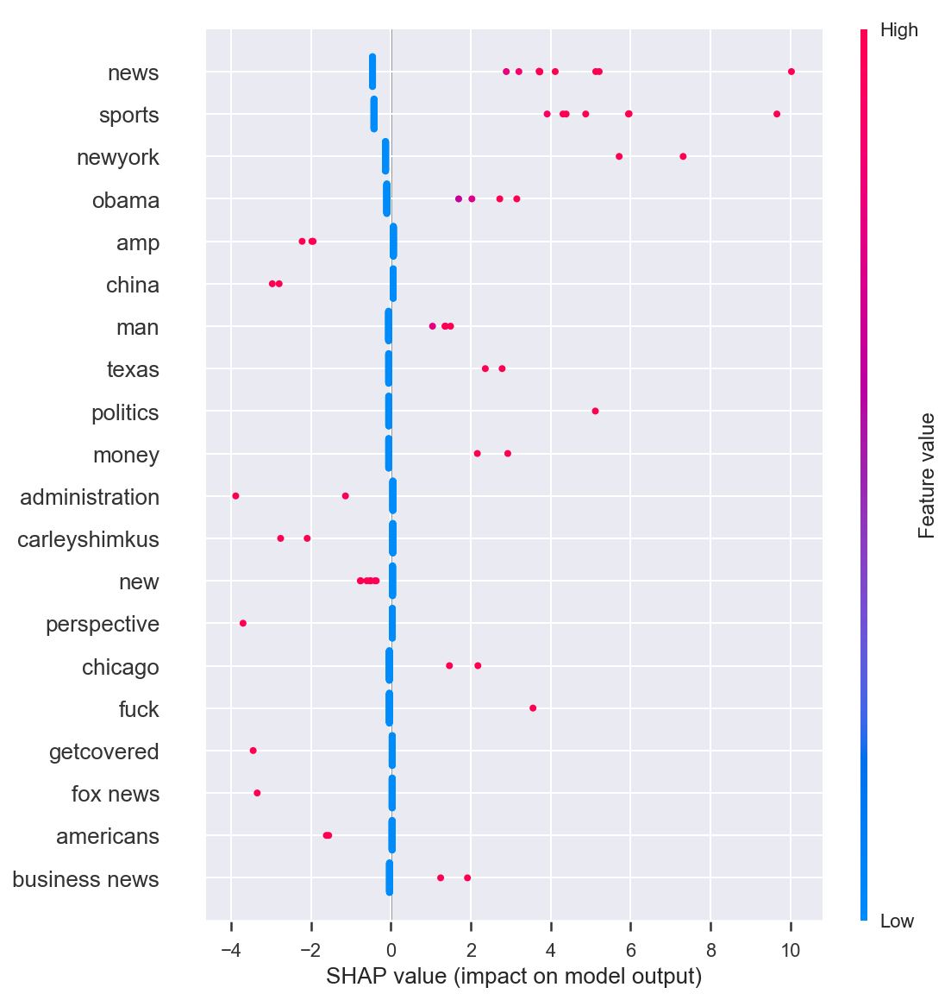

In [59]:
shap.summary_plot(shap_values, russian_array, feature_names=LR.named_steps['vect'].get_feature_names())

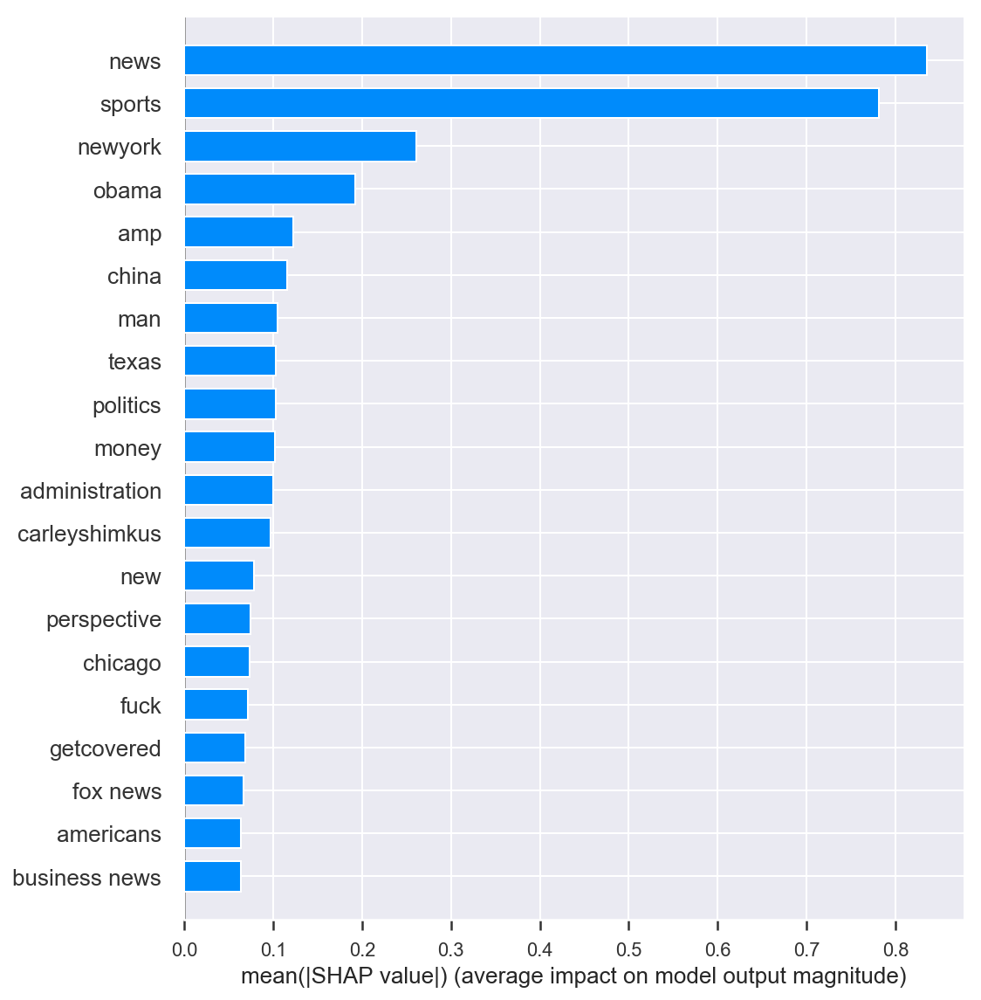

In [60]:
shap.summary_plot(shap_values, russian_array, feature_names=LR.named_steps['vect'].get_feature_names(), plot_type="bar")

### CHART 14A  and 14B (ABOVE): Overview of features most important for the LogReg model's predictions of the unseen test set.

The two charts above give a good overview of features which are most important in determining the logreg model's predictions.

The terms "sports", "hillaryclinton", "news" and "trump" were among the top terms that had the greatest impact on whether a tweet is classified real or fake. Provocative terms like "hillaryforprison" and "hillaryclinton fuck" also stood out, reflecting the politically-charged times and the Russian influence campaign's attempt to exploit particular divisions in the American electorate.

According to SHAP's documentation, the summary plots "sort features by the sum of SHAP value magnitudes over all samples, and uses SHAP values to show the distribution of the impacts each feature has on the model output. The color represents the feature value (red high, blue low)."

SHAP also allows us to examine the predictions for individual tweets, and see what are the features that pushed the model towards a particular prediction

## 6.2 VISUALISING INDIVIDUAL PREDICTIONS
Here's how to interpret the charts and the SHAP values below:

- The model's base value is 0.4327. Anything lower than the base value is classified as real, while anything higher is classified as a state-backed tweet. 

- Certain key words push the model's output value up or down, towards a "real" or "state-backed" prediction, as the charts below show.

In [61]:
ind = 12
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    russian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [62]:
# Correct Prediction
print("State-backed" if y_russian.iloc[ind] else "Real", "Tweet:")
print(X_russian.iloc[ind])

Real Tweet:
an announcement of a summit date is likely to come when trump meets with chinese vice premier liu he at the white h


### ANALYSIS:
Here, we can see that neutral words like "summit" and "premier" helped push the model towards classifying the tweet as real. In this tweet, Trump's name combined with the word "meets" is pushing the model in the opposite direction, but enough to outweigh the impact from the factual words on the right.

Let's look at some troll tweets which the model predicted correctly.

In [63]:
ind = 63
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    russian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [64]:
print("State-backed tweet" if y_russian.iloc[ind] else "Real", "Tweet:")
print(X_russian.iloc[ind])

State-backed tweet Tweet:
hillaryclinton fuck off


In [65]:
ind = 69
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    russian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [66]:
print("State-backed tweet" if y_russian.iloc[ind] else "Real", "Tweet:")
print(X_russian.iloc[ind])

State-backed tweet Tweet:
hillaryclinton hillaryforprison


In [67]:
# Interestingly, the term "hillaryforprison" hasn't appeared in the training set all that much
combo5050['clean_tweet_text'].str.contains('hillaryforprison').value_counts()

False    49971
True        29
Name: clean_tweet_text, dtype: int64

### ANALYSIS:
The model correctly classified these two tweets as state-backed tweets and it is interesting to see what pushed it towards that prediction - provocative terms like "hillaryforprison" and swear words like "fuck". What's even more surprising is that these terms did not appear that often in the training data, but their appearance in the test set was enough to push the model towards a correct prediction.

## 6.3 USING SHAP TO ANALYSE WRONG PREDICTIONS
What caused the model to predict wrongly on those occassions that it classified fake tweets as real, or real tweets as fake? Let's see if SHAP can tell us more about where the model made mistakes.

In [68]:
ind = 38
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    russian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [69]:
# Wrong prediction by model. This was a real tweet that the model classified as fake
print("State-backed" if y_russian.iloc[ind] else "Real", "Tweet:")
print(X_russian.iloc[ind])

Real Tweet:
when clinton got caught with her private email server most of the folks i knew in the natsec community were pissed


### ANALYSIS:
This was a somewhat close call - the SHAP value of 0.71 was close to the baseline of 0.4327. But the words "pissed", "private email", and "caught" pushed the model towards classifying this as a troll tweet - when it was in fact written by Dan Drezner, a Professor at The Fletcher School and a columnist for the Washington Post.

In [70]:
ind = 49
shap.force_plot(
    explainer.expected_value,
    shap_values[ind, :],
    russian_array[ind, :],
    feature_names=LR.named_steps['vect'].get_feature_names(),
)

In [71]:
# Wrong prediction by model. This was a fake tweet that the model classified as real
# But SHAP classified it correctly as a real tweet, again contradicting the model's predictions
print("State-backed" if y_russian.iloc[ind] else "Real", "Tweet:")
print(X_russian.iloc[ind])

State-backed Tweet:
thanks to all women in uniform who served and serve our country beingpatriotic militarywomen usarmy patriots


### ANALYSIS:
This tweet is a good example of how machine models can be defeated at times by factual, seemingly innocuous tweets like this. Harmless words like "uniform", "served", and "thanks" pushed it towards predicting this as a real tweet, when it was in fact a troll tweet.

The state-backed trolls will always try to disguise their true intentions by slipping the manipulative tweets amid lots of fairly harmless ones. As such, the best way to catch the trolls is by not relying excessively on one tool or one approach.

In the notebook3.1, I will test this model against test sets comprising troll tweets from Iran and Venezuela to see if it can generalise well.